In [1]:
import numpy as np 
import os 
from sklearn.metrics import confusion_matrix
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt 
import warnings 
warnings.filterwarnings('ignore')

# Class Names

In [2]:
class_names=['cats','dogs']
class_names_label={class_names:i for i, class_names in enumerate(class_names)}

W,H=224,224
print(class_names_label)

{'cats': 0, 'dogs': 1}


# Loading Datasets

In [3]:
train_image_directory="/kaggle/input/catsdogs-trainvalid-80pc-prepd/trainvalidfull4keras/train"
batch_size=15

train_data = tf.keras.utils.image_dataset_from_directory(train_image_directory,
                                                         validation_split=0.2,
                                                         seed=123,
                                                         subset="training",
                                                         image_size=(H, W),
                                                         batch_size=batch_size)


valid_image_directory="/kaggle/input/catsdogs-trainvalid-80pc-prepd/trainvalidfull4keras/valid"
batch_size=15

validation_data = tf.keras.utils.image_dataset_from_directory(valid_image_directory,
                                                         seed=123,
                                                         image_size=(H, W),
                                                         batch_size=batch_size)


test_image_directory="/kaggle/input/cats-and-dogs-image-classification/test"
batch_size=15

test_data = tf.keras.utils.image_dataset_from_directory(valid_image_directory,
                                                         seed=123,
                                                         image_size=(H, W),
                                                         batch_size=batch_size)

Found 20000 files belonging to 2 classes.
Using 16000 files for training.
Found 5000 files belonging to 2 classes.
Found 5000 files belonging to 2 classes.


In [4]:
for image, lable in train_data.take(1):
    print(f"Image shape with Batch_Size:{image.shape}")
    print("_____________________________________________")
    print(f"Shape of the image is:{image[0].shape}")
    print("_____________________________________________")
    print(f"Label of the image is:{class_names[lable[0]]}")
    print("_____________________________________________")
    print(f"Image is in the form of tensor:{image[0]}")

Image shape with Batch_Size:(15, 224, 224, 3)
_____________________________________________
Shape of the image is:(224, 224, 3)
_____________________________________________
Label of the image is:dogs
_____________________________________________
Image is in the form of tensor:[[[103.749954  60.74996   18.258888]
  [146.35149  100.85527   58.775253]
  [151.01537  102.64314   61.232246]
  ...
  [ 47.940334  29.141403  31.72141 ]
  [ 56.99643   37.913494  40.895638]
  [ 59.206905  37.547916  41.605087]]

 [[126.561966  83.7711    46.537067]
  [117.84664   73.53638   34.087513]
  [123.417946  77.47152   35.79018 ]
  ...
  [ 61.211555  43.925297  36.203712]
  [ 64.08452   45.170364  39.332466]
  [ 57.70381   37.78864   31.348906]]

 [[216.49393  176.19054  147.6591  ]
  [125.39718   85.867615  52.153328]
  [100.83474   59.8584    18.787407]
  ...
  [ 72.77282   55.31746   40.228176]
  [ 74.959114  57.326244  42.325718]
  [ 69.57402   49.91573   34.585735]]

 ...

 [[144.8233   183.4191   2

# Display Some of Images

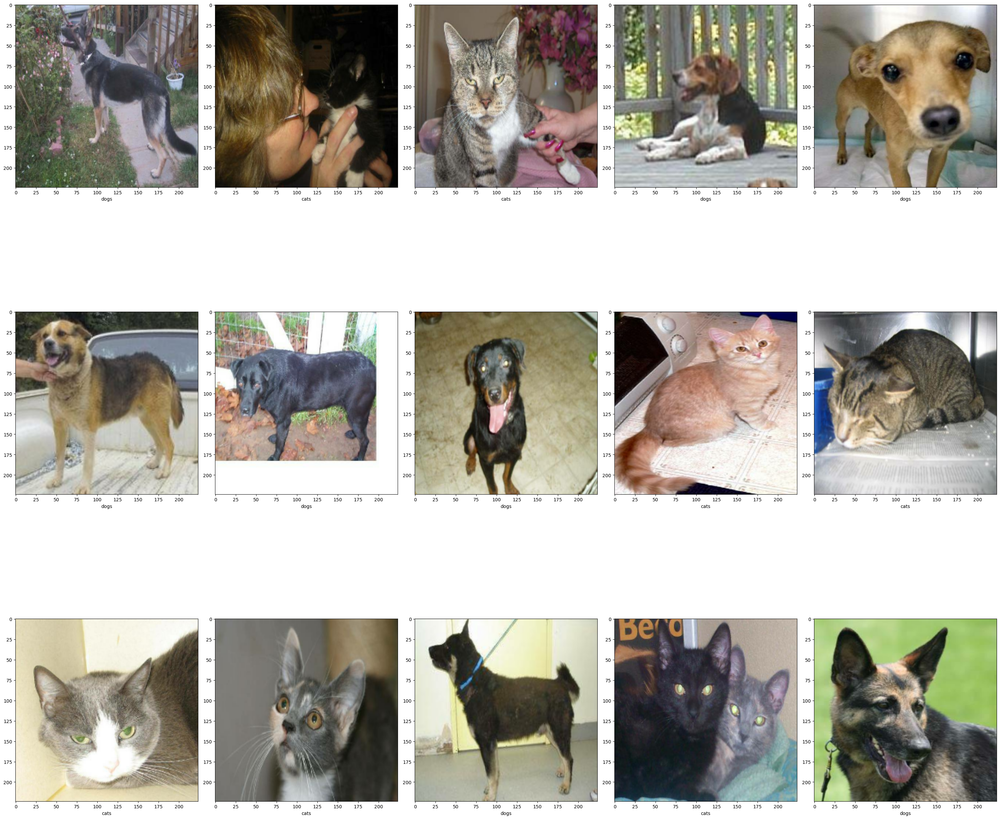

In [5]:
plt.figure(figsize=(30,30), tight_layout=True)
for image, label in train_data.take(1):
    for i in range(15):
        plt.subplot(3,5,i+1)
        plt.imshow(image[i].numpy().astype('uint8'))
        plt.xlabel(class_names[label[i]])
    
    plt.show()

# ِBuild ResNet50 & CNN

In [6]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Flatten

num_classes=2
weights_path='/kaggle/input/d/alexisbcook/resnet50/resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5'


res_model=ResNet50(include_top=False, pooling='avg', weights=weights_path)

model=Sequential()


model.add(res_model)
model.add(Flatten())
model.add(Dense(num_classes, activation='softmax'))

model.layers[0].trainable=False
model.build(input_shape=(None, 224, 224, 3))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 2048)           │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 2)              │         4,098 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,591,810 (90.00 MB)

 Trainable params: 4,098 (16.01 KB)

 Non-trainable params: 23,587,712 (89.98 MB)

# Apply Augmentation

In [7]:
from keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
    
# Make datagen for Train generator
train_datagen = ImageDataGenerator(
                                   horizontal_flip=True,
                                   preprocessing_function=preprocess_input
                               
                                  )

# Train generator
train_generator = train_datagen.flow_from_directory(train_image_directory,
                                                    target_size=(H, W), 
                                                    batch_size=100, 
                                                    class_mode='categorical')
                                                    
# Make datagen for validation generator
validation_datagen = ImageDataGenerator(  preprocessing_function=preprocess_input) 

# Validation generator 
validation_generator = validation_datagen.flow_from_directory( valid_image_directory,
                                                                target_size=(H, W), 
                                                                batch_size=100, 
                                                                class_mode='categorical',

                                                             )
   


Found 20000 images belonging to 2 classes.
Found 5000 images belonging to 2 classes.


In [8]:
# Training the model 
fit_history = model.fit( train_generator, 
                    validation_data=validation_generator,
                    steps_per_epoch=10,
                    epochs=5,
                    batch_size=100,
                    validation_steps=10
                    )


Epoch 1/5
10/10 ━━━━━━━━━━━━━━━━━━━━ 207s 20s/step - accuracy: 0.6527 - loss: 0.7277 - val_accuracy: 0.9150 - val_loss: 0.2299
Epoch 2/5
10/10 ━━━━━━━━━━━━━━━━━━━━ 192s 20s/step - accuracy: 0.9499 - loss: 0.1725 - val_accuracy: 0.9560 - val_loss: 0.1185
Epoch 3/5
10/10 ━━━━━━━━━━━━━━━━━━━━ 190s 20s/step - accuracy: 0.9666 - loss: 0.0935 - val_accuracy: 0.9650 - val_loss: 0.0837
Epoch 4/5
10/10 ━━━━━━━━━━━━━━━━━━━━ 190s 20s/step - accuracy: 0.9805 - loss: 0.0785 - val_accuracy: 0.9750 - val_loss: 0.0713
Epoch 5/5
10/10 ━━━━━━━━━━━━━━━━━━━━ 191s 20s/step - accuracy: 0.9737 - loss: 0.0917 - val_accuracy: 0.9720 - val_loss: 0.0699


In [9]:
print(fit_history.history.keys())


dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])


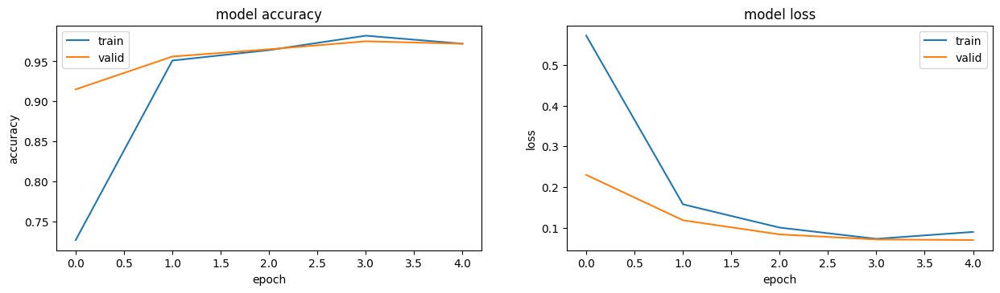

In [10]:
 plt.figure(1, figsize = (15,8)) 
    
plt.subplot(221)  
plt.plot(fit_history.history['accuracy'])  
plt.plot(fit_history.history['val_accuracy'])  
plt.title('model accuracy')  
plt.ylabel('accuracy')  
plt.xlabel('epoch')  
plt.legend(['train', 'valid']) 
    
plt.subplot(222)  
plt.plot(fit_history.history['loss'])  
plt.plot(fit_history.history['val_loss'])  
plt.title('model loss')  
plt.ylabel('loss')  
plt.xlabel('epoch')  
plt.legend(['train', 'valid']) 

plt.show()

# Model Predict

157/157 ━━━━━━━━━━━━━━━━━━━━ 464s 3s/step


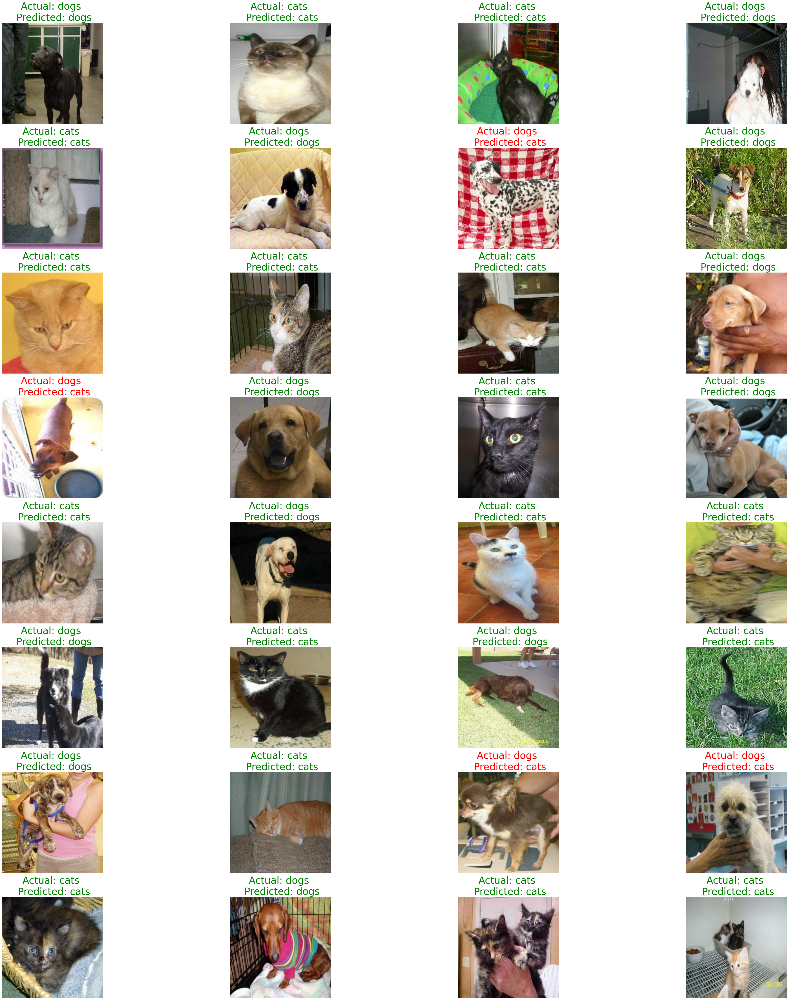

In [11]:
x_val=[]
y_val=[]
y_pred=[]

for images, labels in test_data:
    x_val.extend(images.numpy())
    y_val.extend(labels.numpy())
    

predictions=model.predict(np.array(x_val))
for i in predictions:
    y_pred.append(np.argmax(i))


plt.figure(figsize=(50, 50),tight_layout=True)

for i in range(32):
    ax = plt.subplot(8, 4, i + 1)
    plt.imshow(x_val[i].astype("uint8"))
    actual_label = class_names[y_val[i]]
    predicted_label = class_names[y_pred[i]]
    
    # Check if the actual and predicted labels are the same
    if actual_label == predicted_label:
        label_color = 'green'
    else:
        label_color = 'red'
    
    plt.title(f'Actual: {actual_label} \n Predicted: {predicted_label}', color=label_color, fontsize=35)
    plt.axis("off")

plt.show()